<a href="https://colab.research.google.com/github/cossiomanuel/Thesis_files/blob/main/Deep_learning_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Deep Learning Module
##1. Import all necesary packages

In [ ]:
import numpy as np
import pandas as pd
import os
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import random
from sklearn.utils import shuffle
from tqdm import tqdm
from glob import glob
#import seaborn as sns

## 2. A. Loading the dataset 

In [ ]:
# read the zip file with the data
!pip install -U -q PyDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials


auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

#loading the zip file
fid = drive.ListFile({'q':"title='dataset.zip'"}).GetList()[0]['id']
f = drive.CreateFile({'id': fid})
f.GetContentFile('dataset.zip')

# Unzipping the dataset 
!unzip dataset.zip 

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: train/9a85638e7d8a29bc02f0de3f937827ce98a79471.tif  
  inflating: __MACOSX/train/._9a85638e7d8a29bc02f0de3f937827ce98a79471.tif  
  inflating: train/898d82a450ac7adc097e956b9eaf7b4ae7286983.tif  
  inflating: __MACOSX/train/._898d82a450ac7adc097e956b9eaf7b4ae7286983.tif  
  inflating: train/b2bc0daec2c8c7a154bd0e17f2c79fb851650d73.tif  
  inflating: __MACOSX/train/._b2bc0daec2c8c7a154bd0e17f2c79fb851650d73.tif  
  inflating: train/1da035090ecbced39c2cf209e67d76c364d7588e.tif  
  inflating: __MACOSX/train/._1da035090ecbced39c2cf209e67d76c364d7588e.tif  
  inflating: train/7baf79b7d55c7552393071f4fd98b8f50f40c16a.tif  
  inflating: __MACOSX/train/._7baf79b7d55c7552393071f4fd98b8f50f40c16a.tif  
  inflating: train/1048fd5f36b296f7b76bb5ffbc41c3a19e0da1df.tif  
  inflating: __MACOSX/train/._1048fd5f36b296f7b76bb5ffbc41c3a19e0da1df.tif  
  inflating: train/50d24de9d3dbc78113a08e8dee9009819beffe10.tif  
  inflating: __

In [ ]:
#Try this to see it the zip is erased without affecting the files
!rm dataset.zip

## 2. B. Dataset dataframe

*   Reading the labels
*   Creating the paths (train/test)**





In [ ]:
data = pd.read_csv('train_labels.csv')
train_path = 'train/'
test_path = 'test/'
# quick look at the label stats
#data['label'].value_counts()
data.head()

,id,label
0,f38a6374c348f90b587e046aac6079959adf3835,0
1,c18f2d887b7ae4f6742ee445113fa1aef383ed77,1
2,755db6279dae599ebb4d39a9123cce439965282d,0
3,bc3f0c64fb968ff4a8bd33af6971ecae77c75e08,0
4,068aba587a4950175d04c680d38943fd488d6a9d,0


## 3. A. Read Image Function





In [ ]:
def readImage(path):
    # OpenCV reads the image in bgr format by default

    #print(path) # here to test

    bgr_img = cv2.imread(path)
    # We flip it to rgb for visualization purposes
    b,g,r = cv2.split(bgr_img)
    rgb_img = cv2.merge([r,g,b])
    return rgb_img



## 3. B. Plot Negatives and Positives

Text(0, 0.5, 'Tumoral')

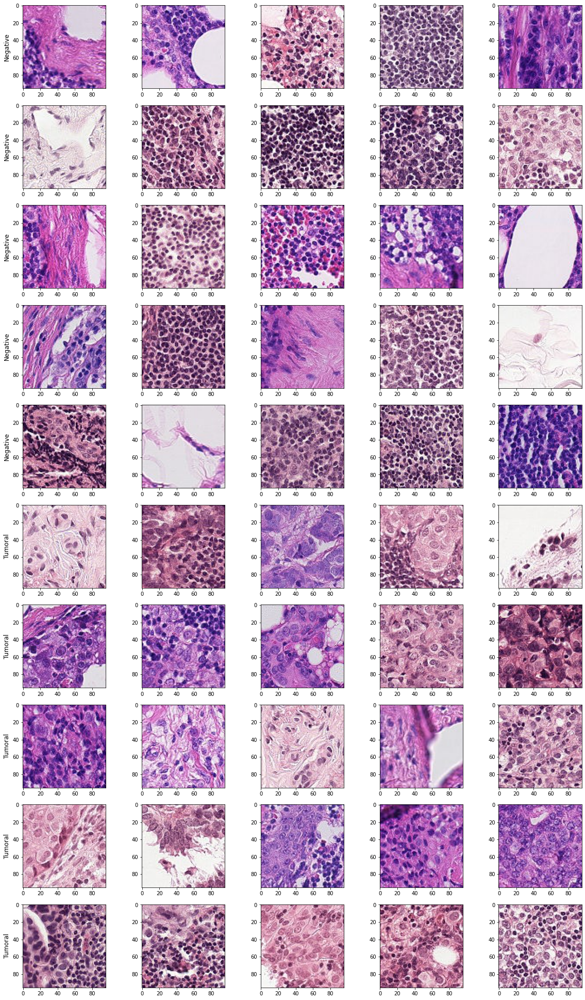

In [ ]:
# random sampling
#shuffled_data = shuffle(data)

fig, ax = plt.subplots(10,5, figsize=(20,35))
#fig.suptitle('Histopathologic scans of lymph node sections',fontsize=20)

# Negatives
shuffled_data = shuffle(data)
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 0]['id'][:5]):
    path = os.path.join(train_path, idx)
    ax[0,i].imshow(readImage(path + '.tif'))
ax[0,0].set_ylabel('Negative', size='large')

shuffled_data = shuffle(data)
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 0]['id'][:5]):
    path = os.path.join(train_path, idx)    
    ax[1,i].imshow(readImage(path + '.tif'))
ax[1,0].set_ylabel('Negative', size='large')

shuffled_data = shuffle(data)
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 0]['id'][:5]):
    path = os.path.join(train_path, idx)
    ax[2,i].imshow(readImage(path + '.tif'))
ax[2,0].set_ylabel('Negative', size='large')

shuffled_data = shuffle(data)
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 0]['id'][:5]):
    path = os.path.join(train_path, idx)
    ax[3,i].imshow(readImage(path + '.tif'))
ax[3,0].set_ylabel('Negative', size='large')

shuffled_data = shuffle(data)
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 0]['id'][:5]):
    path = os.path.join(train_path, idx)
    ax[4,i].imshow(readImage(path + '.tif'))
ax[4,0].set_ylabel('Negative', size='large')

#Positives

shuffled_data = shuffle(data)
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 1]['id'][:5]):
    path = os.path.join(train_path, idx)
    ax[5,i].imshow(readImage(path + '.tif'))   
ax[5,0].set_ylabel('Tumoral', size='large')

shuffled_data = shuffle(data)
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 1]['id'][:5]):
    path = os.path.join(train_path, idx)
    ax[6,i].imshow(readImage(path + '.tif'))   
ax[6,0].set_ylabel('Tumoral', size='large')

shuffled_data = shuffle(data)
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 1]['id'][:5]):
    path = os.path.join(train_path, idx)
    ax[7,i].imshow(readImage(path + '.tif'))   
ax[7,0].set_ylabel('Tumoral', size='large')

shuffled_data = shuffle(data)
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 1]['id'][:5]):
    path = os.path.join(train_path, idx)
    ax[8,i].imshow(readImage(path + '.tif'))   
ax[8,0].set_ylabel('Tumoral', size='large')

shuffled_data = shuffle(data)
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 1]['id'][:5]):
    path = os.path.join(train_path, idx)
    ax[9,i].imshow(readImage(path + '.tif'))   
ax[9,0].set_ylabel('Tumoral', size='large')

What is the difference between a cancerous image and a healthy one? 

In healthy images:

*   Nuclei are uniformaly stained 
*   Nuclei are very blueish
*   B cells have little amount of cytoplasm
*   B cells are together densely packed

In cancerous images:


*   Nuclei are bigger, irregular and not uniformally stained
*   Nuclei can have several tones of blue 
*   They can present an ellongated shape
*   Cells can present a lot of cytoplasm
*   They are very irregular in shape
*   Necrotic tissue and collagen fibers can appear
*   There are a lot of spaces (can be blood vessels) 

There can other traits in cancerous tissue like presence of glands and presence of epithelial cells, where there should only be B-cells. Also in some methastasis, you could find some clusters of cells grouped together sorrounded by scar tissue (collagen fibers) or empty spaces.





## 3. C. 1. Data Augmentation





In [ ]:
shuffled_data = shuffle(data)

import random
ORIGINAL_SIZE = 96      # original size of the images - do not change

# AUGMENTATION VARIABLES
CROP_SIZE = 90          # final size after crop
RANDOM_ROTATION = 3    # range (0-180), 180 allows all rotation variations, 0=no change
RANDOM_SHIFT = 2        # center crop shift in x and y axes, 0=no change. This cannot be more than (ORIGINAL_SIZE - CROP_SIZE)//2 
RANDOM_BRIGHTNESS = 6  # range (0-100), 0=no change
RANDOM_CONTRAST = 8    # range (0-100), 0=no change
RANDOM_90_DEG_TURN = 1  # 0 or 1= random turn to left or right

def readCroppedImage(path, augmentations = True):
    # augmentations parameter is included for counting statistics from images, where we don't want augmentations
    
    # OpenCV reads the image in bgr format by default
    bgr_img = cv2.imread(path)
    

    #print(path) #just to see what is wrong


    # We flip it to rgb for visualization purposes
    b,g,r = cv2.split(bgr_img)
    rgb_img = cv2.merge([r,g,b])
    
    if(not augmentations):
        return rgb_img / 255
    
    #random rotation
    rotation = random.randint(-RANDOM_ROTATION,RANDOM_ROTATION)
    if(RANDOM_90_DEG_TURN == 1):
        rotation += random.randint(-1,1) * 90
    M = cv2.getRotationMatrix2D((48,48),rotation,1)   # the center point is the rotation anchor
    rgb_img = cv2.warpAffine(rgb_img,M,(96,96))
    
    #random x,y-shift
    x = random.randint(-RANDOM_SHIFT, RANDOM_SHIFT)
    y = random.randint(-RANDOM_SHIFT, RANDOM_SHIFT)
    
    # crop to center and normalize to 0-1 range
    start_crop = (ORIGINAL_SIZE - CROP_SIZE) // 2
    end_crop = start_crop + CROP_SIZE
    rgb_img = rgb_img[(start_crop + x):(end_crop + x), (start_crop + y):(end_crop + y)] / 255
    
    # Random flip
    flip_hor = bool(random.getrandbits(1))
    flip_ver = bool(random.getrandbits(1))
    if(flip_hor):
        rgb_img = rgb_img[:, ::-1]
    if(flip_ver):
        rgb_img = rgb_img[::-1, :]
        
    # Random brightness
    br = random.randint(-RANDOM_BRIGHTNESS, RANDOM_BRIGHTNESS) / 100.
    rgb_img = rgb_img + br
    
    # Random contrast
    cr = 1.0 + random.randint(-RANDOM_CONTRAST, RANDOM_CONTRAST) / 100.
    rgb_img = rgb_img * cr
    
    # clip values to 0-1 range
    rgb_img = np.clip(rgb_img, 0, 1.0)
    
    return rgb_img

## 4. C. 2. Plot some augmented pictures

Text(0, 0.5, 'Tumoral ')

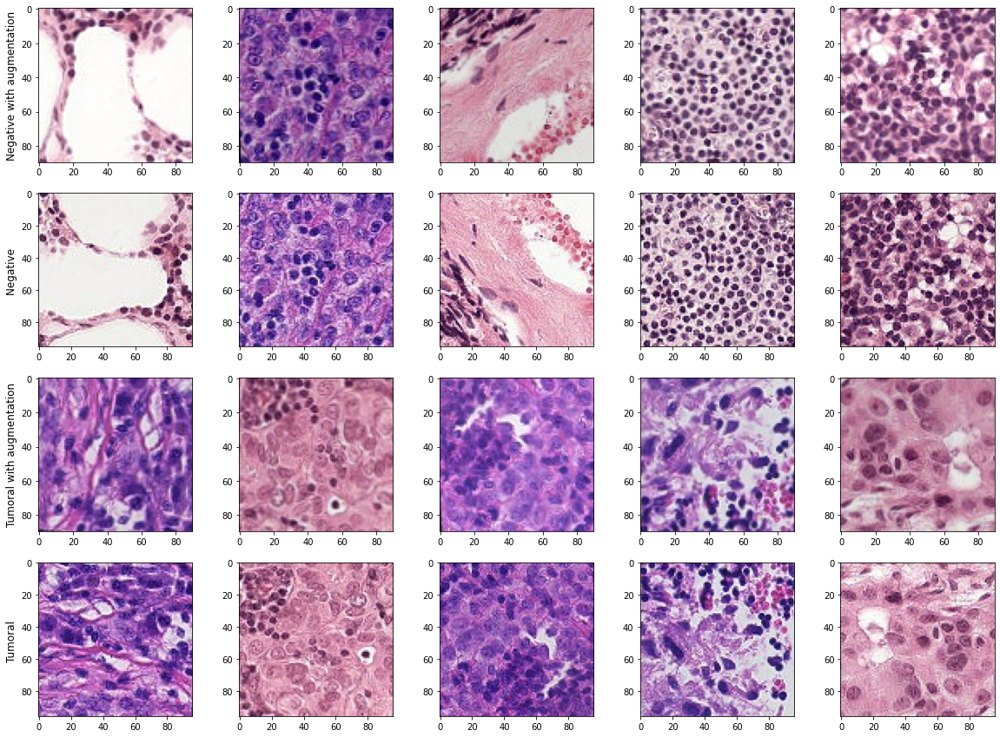

In [ ]:
fig, ax = plt.subplots(4,5, figsize=(20,15))
#fig.suptitle('Cropped histopathologic scans of lymph node sections',fontsize=20)

# Negatives augmented
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 0]['id'][:5]):
    path = os.path.join(train_path, idx)
    ax[0,i].imshow(readCroppedImage(path + '.tif'))
ax[0,0].set_ylabel('Negative with augmentation', size='large')

# Negative not augmented
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 0]['id'][:5]):
    path = os.path.join(train_path, idx)
    ax[1,i].imshow(readImage(path + '.tif'))   
ax[1,0].set_ylabel('Negative ', size='large')

# Positives augmented
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 1]['id'][:5]):
    path = os.path.join(train_path, idx)
    ax[2,i].imshow(readCroppedImage(path + '.tif'))
ax[2,0].set_ylabel('Tumoral with augmentation', size='large')

# Positives augmented

for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 1]['id'][:5]):
    path = os.path.join(train_path, idx)
    ax[3,i].imshow(readImage(path + '.tif'))   
ax[3,0].set_ylabel('Tumoral ', size='large')




## 5. Function for HE image normalization, Hematoxilin extraction and Eosin extraction



In [ ]:
def normalizeStaining(img, saveFile=None, Io=255, alpha=1, beta=0.15):
    ''' Normalize staining appearence of H&E stained images
    
    Example use:
        see test.py
        
    Input:
        I: RGB input image
        Io: (optional) transmitted light intensity
        
    Output:
        Inorm: normalized image
        H: hematoxylin image
        E: eosin image
    
    Reference: 
        A method for normalizing histology slides for quantitative analysis. M.
        Macenko et al., ISBI 2009
    '''
             
    HERef = np.array([[0.5626, 0.2159],
                      [0.7201, 0.8012],
                      [0.4062, 0.5581]])
        
    maxCRef = np.array([1.9705, 1.0308])
    
    # define height and width of image
    h, w, c = img.shape
    
    # reshape image
    img = img.reshape((-1,3))

    # calculate optical density
    OD = -np.log((img.astype(np.float)+1)/Io)
    
    # remove transparent pixels
    ODhat = OD[~np.any(OD<beta, axis=1)]
        
    # compute eigenvectors
    eigvals, eigvecs = np.linalg.eigh(np.cov(ODhat.T))
    
    #eigvecs *= -1
    
    #project on the plane spanned by the eigenvectors corresponding to the two 
    # largest eigenvalues    
    That = ODhat.dot(eigvecs[:,1:3])
    
    phi = np.arctan2(That[:,1],That[:,0])
    
    minPhi = np.percentile(phi, alpha)
    maxPhi = np.percentile(phi, 100-alpha)
    
    vMin = eigvecs[:,1:3].dot(np.array([(np.cos(minPhi), np.sin(minPhi))]).T)
    vMax = eigvecs[:,1:3].dot(np.array([(np.cos(maxPhi), np.sin(maxPhi))]).T)
    
    # a heuristic to make the vector corresponding to hematoxylin first and the 
    # one corresponding to eosin second
    if vMin[0] > vMax[0]:
        HE = np.array((vMin[:,0], vMax[:,0])).T
    else:
        HE = np.array((vMax[:,0], vMin[:,0])).T
    
    # rows correspond to channels (RGB), columns to OD values
    Y = np.reshape(OD, (-1, 3)).T
    
    # determine concentrations of the individual stains
    C = np.linalg.lstsq(HE,Y, rcond=None)[0]
    
    # normalize stain concentrations
    maxC = np.array([np.percentile(C[0,:], 99), np.percentile(C[1,:],99)])
    tmp = np.divide(maxC,maxCRef)
    C2 = np.divide(C,tmp[:, np.newaxis])
    
    # recreate the image using reference mixing matrix
    Inorm = np.multiply(Io, np.exp(-HERef.dot(C2)))
    Inorm[Inorm>255] = 254
    Inorm = np.reshape(Inorm.T, (h, w, 3)).astype(np.uint8)  
    
    # unmix hematoxylin and eosin
    H = np.multiply(Io, np.exp(np.expand_dims(-HERef[:,0], axis=1).dot(np.expand_dims(C2[0,:], axis=0))))
    H[H>255] = 254
    H = np.reshape(H.T, (h, w, 3)).astype(np.uint8)
    
    E = np.multiply(Io, np.exp(np.expand_dims(-HERef[:,1], axis=1).dot(np.expand_dims(C2[1,:], axis=0))))
    E[E>255] = 254
    E = np.reshape(E.T, (h, w, 3)).astype(np.uint8)
    
    if saveFile is not None:
        Image.fromarray(Inorm).save(saveFile+'.png')
        Image.fromarray(H).save(saveFile+'_H.png')
        Image.fromarray(E).save(saveFile+'_E.png')

    return Inorm, H, E

In [ ]:
# This function will normalized all images and then produce a list of files

from scipy import misc
from PIL import Image


# to create a folder
!rm -rf ./normalized_images_new
!mkdir normalized_images_new

images_id = []

def main():

    
    outPath = "normalized_images_new/"
    path = "train/"
    N = len(os.listdir(path))  # total len(os.listdir(path))

    # iterate through the names of contents of the folder
    for i, image_path in enumerate(tqdm(os.listdir(path))):

      if i == N:
            break

      try:
        
        # create the full input path and read the file
        input_path = os.path.join(path, image_path)
        rgb_image = readImage(input_path)

        # normalize H&E
        Inorm, H, E = normalizeStaining(rgb_image)

        # create full output path, 'example.jpg' 
        # becomes 'rotate_example.jpg', save the file to disk
        fullpath = os.path.join(outPath + image_path)
        im = Image.fromarray(E)
        im.save(fullpath)
        # To get only the name of the file (no extension)
        to_save_path = os.path.basename(fullpath)
        images_id.append(os.path.splitext(to_save_path)[0])

      except:
        pass

if __name__ == '__main__':
    main()


#TODO create a df that can store path, name and label to use it in the function

  0%|          | 75/220026 [00:01<51:34, 71.09it/s]/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/usr/local/lib/python3.6/dist-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:40: RuntimeWarning: Degrees of freedom <= 0 for slice
/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2480: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)
/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:2480: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)
  2%|▏         | 4699/220026 [01:03<50:29, 71.08it/s]/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.6/dist-packages/ipykern

In [ ]:
# This function will take the list name of the images processed and 
# generate a df with the labels and the reseted index

trial_df = data.copy()
normalized_trial = trial_df.loc[trial_df['id'].isin(images_id)]
normalized_trial = normalized_trial.reset_index(drop=True)


# Feed [normalized_trial] as df for the CNN processing 


Text(0, 0.5, 'Eosin image')

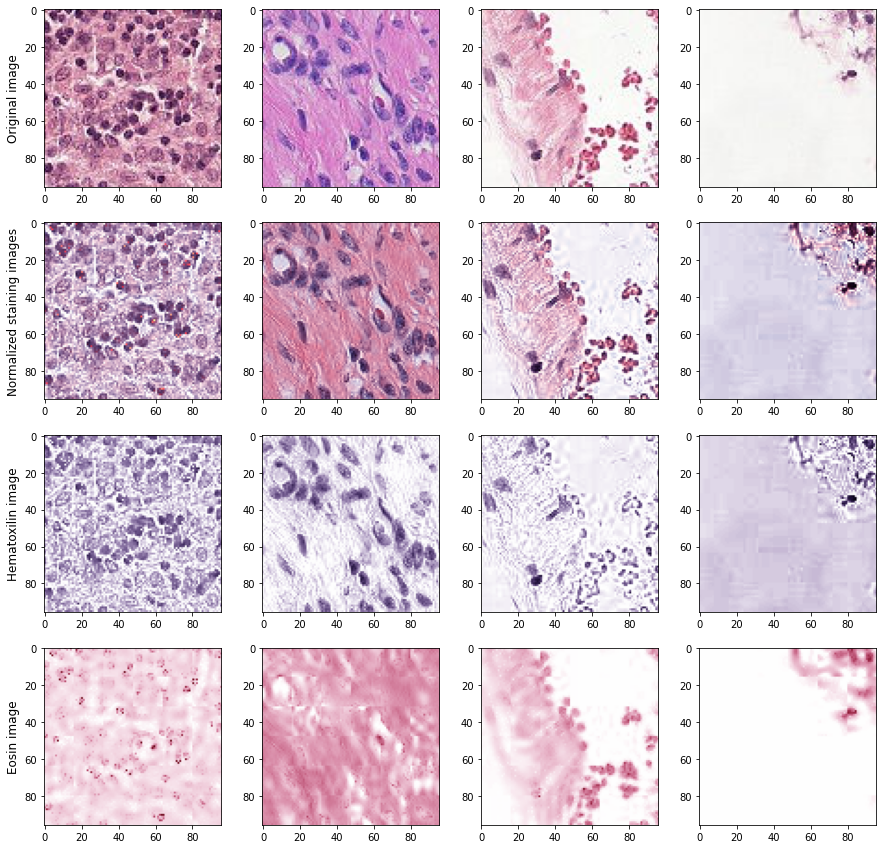

In [ ]:
# Plot NEGATIVE normalized staining images, Hematoxilin only and Eosin only.

fig, ax = plt.subplots(4,4, figsize=(15,15))
#fig.suptitle('Negative',fontsize=20)


# Normalized staining
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 0]['id'][:4]):
    path = os.path.join(train_path, idx)
    rgb_image = readImage(path + '.tif')
    ax[0,i].imshow(rgb_image)
ax[0,0].set_ylabel('Original image', size='large')


# Normalized staining
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 0]['id'][:4]):
    path = os.path.join(train_path, idx)
    rgb_image = readImage(path + '.tif')
    Inorm, H, E = normalizeStaining(rgb_image)   
    ax[1,i].imshow(Inorm)
ax[1,0].set_ylabel('Normalized staining images', size='large')


# Normalized staining
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 0]['id'][:4]):
    path = os.path.join(train_path, idx)
    rgb_image = readImage(path + '.tif')
    Inorm, H, E = normalizeStaining(rgb_image)   
    ax[2,i].imshow(H)
ax[2,0].set_ylabel('Hematoxilin image', size='large')


# Normalized staining
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 0]['id'][:4]):
    path = os.path.join(train_path, idx)
    rgb_image = readImage(path + '.tif')
    Inorm, H, E = normalizeStaining(rgb_image)   
    ax[3,i].imshow(E)
ax[3,0].set_ylabel('Eosin image', size='large')



Text(0, 0.5, 'Eosin image')

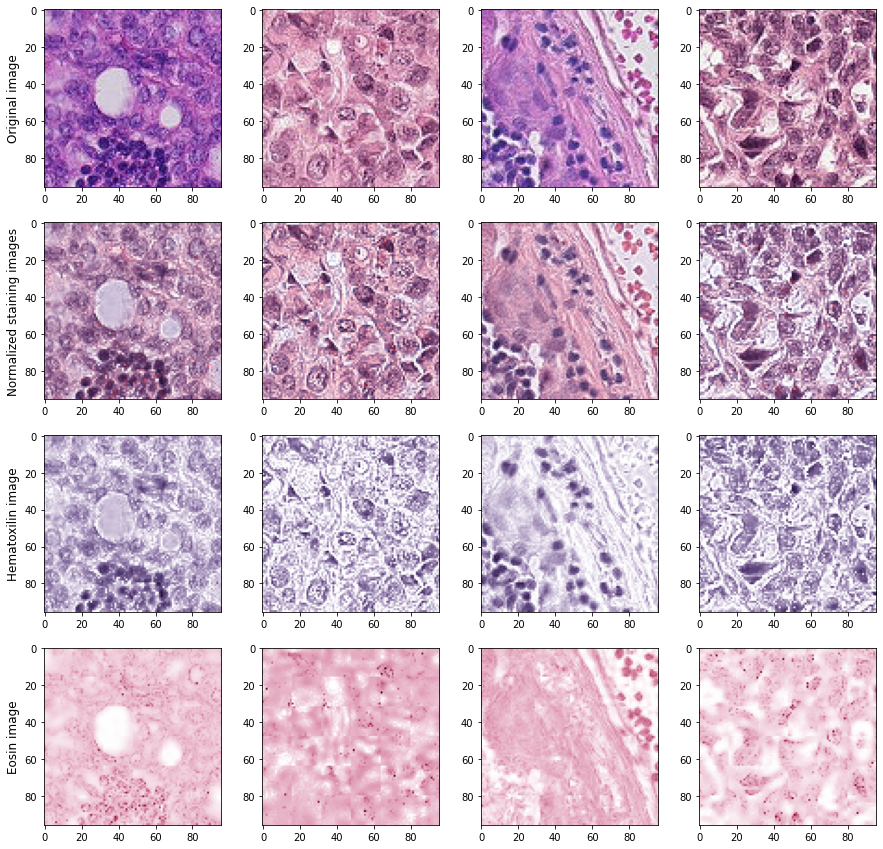

In [ ]:
# Plot POSITIVE normalized staining images, Hematoxilin only and Eosin only.

fig, ax = plt.subplots(4,4, figsize=(15,15))
#fig.suptitle('Positive',fontsize=20)


# Normalized staining
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 1]['id'][:4]):
    path = os.path.join(train_path, idx)
    rgb_image = readImage(path + '.tif')
    ax[0,i].imshow(rgb_image)
ax[0,0].set_ylabel('Original image', size='large')


# Normalized staining
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 1]['id'][:4]):
    path = os.path.join(train_path, idx)
    rgb_image = readImage(path + '.tif')
    Inorm, H, E = normalizeStaining(rgb_image)   
    ax[1,i].imshow(Inorm)
ax[1,0].set_ylabel('Normalized staining images', size='large')


# Normalized staining
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 1]['id'][:4]):
    path = os.path.join(train_path, idx)
    rgb_image = readImage(path + '.tif')
    Inorm, H, E = normalizeStaining(rgb_image)   
    ax[2,i].imshow(H)
ax[2,0].set_ylabel('Hematoxilin image', size='large')


# Normalized staining
for i, idx in enumerate(shuffled_data[shuffled_data['label'] == 1]['id'][:4]):
    path = os.path.join(train_path, idx)
    rgb_image = readImage(path + '.tif')
    Inorm, H, E = normalizeStaining(rgb_image)   
    ax[3,i].imshow(E)
ax[3,0].set_ylabel('Eosin image', size='large')


## ** 6. D. 1. Function for outlier detection 





In [ ]:
# As we count the statistics, we can check if there are any completely black or white images
dark_th = 120 / 255      # If no pixel reaches this threshold, image is considered too dark
bright_th = 135 / 255   # If no pixel is under this threshold, image is considerd too bright
too_dark_idx = []
too_bright_idx = []

x_tot = np.zeros(3)
x2_tot = np.zeros(3)
counted_ones = 0
for i, idx in tqdm(enumerate(shuffled_data['id']), 'computing statistics...(220025 it total)'):
    path = os.path.join(train_path, idx)
    imagearray = readCroppedImage(path + '.tif', augmentations = False).reshape(-1,3)
    # is this too dark
    if(imagearray.max() < dark_th):
        too_dark_idx.append(idx)
        continue # do not include in statistics
    # is this too bright
    if(imagearray.min() > bright_th):
        too_bright_idx.append(idx)
        continue # do not include in statistics
    x_tot += imagearray.mean(axis=0)
    x2_tot += (imagearray**2).mean(axis=0)
    counted_ones += 1
    
channel_avr = x_tot/counted_ones
channel_std = np.sqrt(x2_tot/counted_ones - channel_avr**2)
channel_avr,channel_std

computing statistics...(220025 it total): 1449it [00:01, 757.58it/s]


KeyboardInterrupt: ignored

## 6. D. 2. Counting outliers according threshold

In [ ]:
print('There was {0} extremely dark image'.format(len(too_dark_idx)))
print('and {0} extremely bright images'.format(len(too_bright_idx)))
print('Dark one:')
print(too_dark_idx)
print('Bright ones:')
print(too_bright_idx)

There was 140 extremely dark image
and 394 extremely bright images
Dark one:
['c166012fe03fd5510e27e4db9cf1e013e1737d07', '8246de06c2a738f8466eecbf471e40f7fda6893f', '4a96fbe4b4b795d58d27cc7ccaf94b9c695b2614', '574c8303cffd0362ddf6ebfcdf0696cc219e7e26', '220bde79c668701c461e85dfece526b304cdbdf5', '1c0998a08643c80be4a49c3b26af6dc1a48c3be4', '31d4d85591a85cbd883244aff22b8d4eeb66b88e', '72c34a6f359dea0f902db26582de65fb58b946bb', '554c8bbd4913b9d39f32970424164a4440d9383a', 'b9845d19d6e220c1f9194b759ef3f2a26ca9b3b6', '0312f2eefa9368ccb2a13ee22b6d8433fcffffe9', '32a93c776a143ada536dda90b3da5b546b910fc3', '6dcfa0f825d36216b2e17074bf159595f4604622', 'cb0d6df35c74f949718004c83e976eaf62c86722', '6a2b32287508681f98ad94666fda72047eb09f32', 'deb61a96a8c2a023f5af02f76652581de6884ae6', 'c15c692cc9f0e0ad9acb8accd382c8fd2c86f903', 'ce3d3e9dfbe51dfd3eeb93d9b5f48a7486aa54a5', '79d9759b2f705f7e34f428aa6aa1e3e23413fe42', 'caaa31ce952d0f09c82f4c4e117e2de4e31c2974', '95e06a6aa73c9d5837c35c5a7a844d0b38e8fa40'

## 6. D. 3. Plotting some random outliers

This is important so we can have a look of what kind of outliers are being considered.

## 6. D. 3.1 Plotting the darker ones

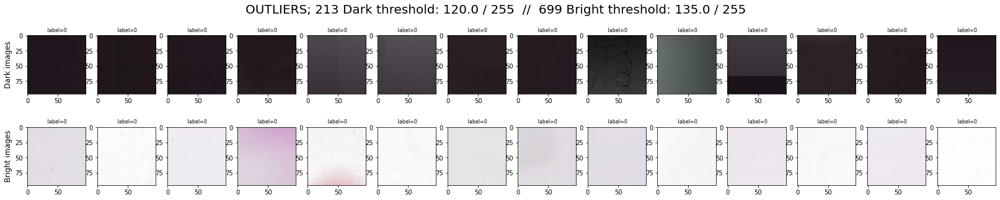

In [ ]:
fig, ax = plt.subplots(2,14, figsize=(28,5))
fig.suptitle('OUTLIERS; ' + str(len(too_dark_idx)) + ' Dark threshold: ' + str(dark_th*255) + ' / 255  //  ' +
   str(len(too_bright_idx)) + ' Bright threshold: ' + str(bright_th*255) + ' / 255' ,fontsize=20)


# Too dark
i = 0
for idx in np.asarray(shuffle(too_dark_idx))[:min(14, len(too_dark_idx))]:
    lbl = shuffled_data[shuffled_data['id'] == idx]['label'].values[0]
    path = os.path.join(train_path, idx)
    ax[0,i].imshow(readCroppedImage(path + '.tif', augmentations = False))
    ax[0,i].set_title('\n label=' + str(lbl), fontsize = 8)
    i += 1
ax[0,0].set_ylabel('Dark images', size='large')
for j in range(min(14, len(too_dark_idx)), 14):
    ax[0,j].axis('off') # hide axes if there are less than 14 (not plot any space)
# Too bright
i = 0
for idx in np.asarray(shuffle(too_bright_idx))[:min(14, len(too_bright_idx))]:
    lbl = shuffled_data[shuffled_data['id'] == idx]['label'].values[0]
    path = os.path.join(train_path, idx)
    ax[1,i].imshow(readCroppedImage(path + '.tif', augmentations = False))
    ax[1,i].set_title('\n label=' + str(lbl), fontsize = 8)    
    i += 1
ax[1,0].set_ylabel('Bright images', size='large')
for j in range(min(14, len(too_bright_idx)), 14):
    ax[1,j].axis('off') # hide axes if there are less than 14 images (no plot any space)


## 7. Deep Learning Model 

## 7.1 General settings
To define the following parameters:
* Testing/validation split
* Batch size
* Architecture
* Pretrained state
* Download the model




In [ ]:
from sklearn.model_selection import train_test_split

# we read the csv file earlier to pandas dataframe, now we set index to id so we can perform
train_df = data.set_index('id') # this is with the standard dataset
#train_df = normalized_trial.set_index('id') # this with the normalized

#If removing outliers from training, uncomment the four lines below
# print('Before removing outliers we had {0} training samples.'.format(train_df.shape[0]))
# train_df = train_df.drop(labels=too_dark_idx, axis=0)
# train_df = train_df.drop(labels=too_bright_idx, axis=0)
# print('After removing outliers we have {0} training samples.'.format(train_df.shape[0]))

train_names = train_df.index.values
train_labels = np.asarray(train_df['label'].values)

# split, this function returns more than we need as we only need the validation indexes for fastai
tr_n, tr_idx, val_n, val_idx = train_test_split(train_names, range(len(train_names)), test_size=0.1, stratify=train_labels, random_state=123)
len(val_idx)

22003

In [ ]:
# Select the model to operate
from fastai import *
from fastai.vision import *
from torchvision.models import *    # import *=all the models from torchvision  

arch = resnet50                     # specify model architecture
BATCH_SIZE = 128                    # specify batch size, hardware restrics this one. Large batch sizes may run out of GPU memory
sz = CROP_SIZE                      # input size is the crop size
MODEL_PATH = str(arch).split()[1]   # this will extrat the model name as the model file name e.g. 'resnet50'


In [ ]:
# create dataframe for the fastai loader
# change also the train_path for normalized_images_new 
train_dict = {'name': train_path + train_names, 'label': train_labels} # with original images

#train_normalized_path = "normalized_images_new/" # normalized_images_path
#train_dict = {'name': train_normalized_path + train_names, 'label': train_labels} # with normalized images

df = pd.DataFrame(data=train_dict)


# create test dataframe
test_names = []
for f in os.listdir(test_path):
    test_names.append(test_path + f)
df_test = pd.DataFrame(np.asarray(test_names), columns=['name'])

print('Our testing set has {0} samples.'.format(df_test.shape[0]))


Our testing set has 57458 samples.


In [ ]:
# Subclass ImageList to use our own image opening function
class MyImageItemList(ImageList):
    def open(self, fn:PathOrStr)->Image:
        img = readCroppedImage(fn.replace('//','').replace('//','/'))
        # This ndarray image has to be converted to tensor before passing on as fastai Image, we can use pil2tensor
        return vision.Image(px=pil2tensor(img, np.float32))
    

In [ ]:
imgDataBunch = (MyImageItemList.from_df(path='/', df=df, suffix='.tif')
        #Where to find the data?
        .split_by_idx(val_idx)
        #How to split in train/valid?
        .label_from_df(cols='label')
        #Where are the labels?
        .add_test(MyImageItemList.from_df(path='/', df=df_test))
        #dataframe pointing to the test set?
        .transform(tfms=[[],[]], size=sz)
        # We have our custom transformations implemented in the image loader but we could apply transformations also here
        # Even though we don't apply transformations here, we set two empty lists to tfms. Train and Validation augmentations
        .databunch(bs=BATCH_SIZE)
        # convert to databunch
        .normalize([tensor([0.702447, 0.546243, 0.696453]), tensor([0.238893, 0.282094, 0.216251])])
        # Normalize with training set stats. These are means and std's of each three channel and we calculated these previously in the stats step.
       )

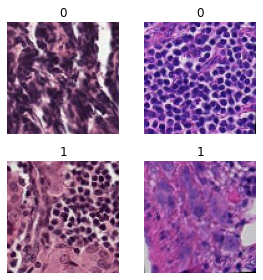

In [ ]:
# check that the imgDataBunch is loading our images ok
imgDataBunch.show_batch(rows=2, figsize=(4,4))


In [ ]:
# Next, we create a convnet learner object
# ps = dropout percentage (0-1) in the final layer
def getLearner():
    return cnn_learner(imgDataBunch, arch, pretrained=True, path='.', metrics=accuracy, ps=0.5, callback_fns=ShowGraph)

learner = getLearner()


Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth


## 7. 2 Weight decay and learning 
Analysis of learning and weight decay to find the best combination.

In [ ]:
# We can use lr_find with different weight decays and record all losses so that we can plot them on the same graph
# Number of iterations is by default 100, but at this low number of itrations, there might be too much variance
# from random sampling that makes it difficult to compare WD's. I recommend using an iteration count of at least 300 for more consistent results.
lrs = []
losses = []
wds = []
iter_count = 600

# WEIGHT DECAY = 1e-6
learner.lr_find(wd=1e-6, num_it=iter_count)
lrs.append(learner.recorder.lrs)
losses.append(learner.recorder.losses)
wds.append('1e-6')
learner = getLearner() #reset learner - this gets more consistent starting conditions

# WEIGHT DECAY = 1e-4
learner.lr_find(wd=1e-4, num_it=iter_count)
lrs.append(learner.recorder.lrs)
losses.append(learner.recorder.losses)
wds.append('1e-4')
learner = getLearner() #reset learner - this gets more consistent starting conditions

# WEIGHT DECAY = 1e-2
learner.lr_find(wd=1e-2, num_it=iter_count)
lrs.append(learner.recorder.lrs)
losses.append(learner.recorder.losses)
wds.append('1e-2')
learner = getLearner() #reset learner

epoch,train_loss,valid_loss,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


epoch,train_loss,valid_loss,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


epoch,train_loss,valid_loss,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


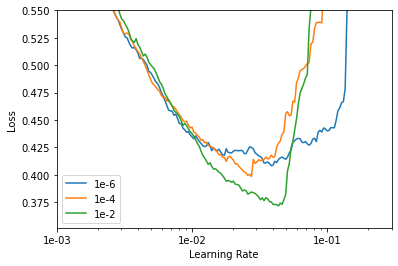

In [ ]:
# Plot weight decays
_, ax = plt.subplots(1,1)
min_y = 0.5
max_y = 0.55
for i in range(len(losses)):
    ax.plot(lrs[i], losses[i])
    min_y = min(np.asarray(losses[i]).min(), min_y)
ax.set_ylabel("Loss")
ax.set_xlabel("Learning Rate")
ax.set_xscale('log')
#ax ranges may need some tuning with different model architectures 
ax.set_xlim((1e-3,3e-1))
ax.set_ylim((min_y - 0.02,max_y))
ax.legend(wds)
ax.xaxis.set_major_formatter(plt.FormatStrFormatter('%.0e'))

## 7. 3 Training cycles
With the values chosen (or not) from the previous stage (learning rate and weight decay).

epoch,train_loss,valid_loss,accuracy,time
0,0.443460,0.511181,0.838579,03:05
1,0.391773,0.367208,0.840583,02:59
2,0.354024,0.437595,0.826828,02:58
3,0.332770,0.347464,0.855386,02:58
4,0.323408,0.474321,0.873332,02:58
5,0.303684,0.526955,0.876657,02:58
6,0.299100,1.672043,0.885539,02:58
7,0.284858,0.277144,0.886176,02:58


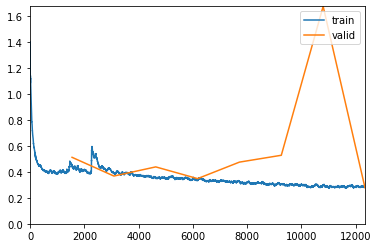

In [ ]:
max_lr = 2e-2
wd = 1e-4
# 1cycle policy
learner.fit_one_cycle(cyc_len=8, max_lr=max_lr, wd=wd)

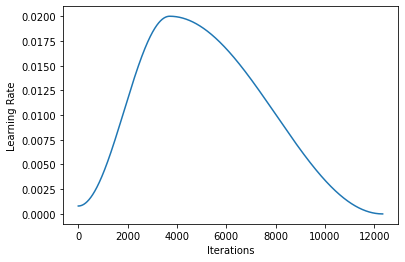

In [ ]:
# plot learning rate of the one cycle
learner.recorder.plot_lr()

Is the model learning????


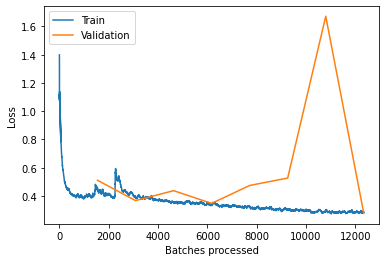

In [ ]:
# and plot the losses of the first cycle
learner.recorder.plot_losses()

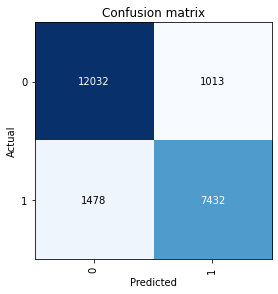

In [ ]:
interp = ClassificationInterpretation.from_learner(learner)
interp.plot_confusion_matrix(title='Confusion matrix')

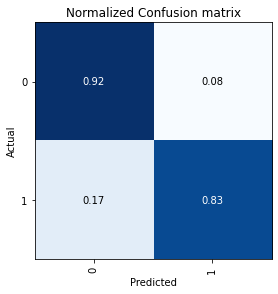

In [ ]:
interp.plot_confusion_matrix(title='Normalized Confusion matrix', normalize='true')

## 7.4 Integrative measurements
To evaluate in depth the training process

In [ ]:
# Measures of accuracy and performance
# We need to make a table with this and the accuracy of the best epoch

CM = interp.confusion_matrix()
TP = CM[1][1]
TN = CM[0][0]
FN = CM[1][0]
FP = CM[0][1] 

error_rate = (FP + FN) / (FP + FN + TP + TN)
accuracy = (TP + TN) / (FP + FN + TP + TN)

sensitivity = TP / (TP + FN)
specificity = TN / (TN + FP)

precision = TP / (TP + FP)

false_pos_rate = FP / (TP + FN)
false_neg_rate = FN / (TN + FP)

F1_score = TP / (TP + ((FP + FN)/2))


summary = pd.DataFrame({'error_rate':[error_rate], 'accuracy':[accuracy], 'sensitivity':[sensitivity],
                        'specificity':[specificity], 'precision':[precision], 'false_pos_rate':[false_pos_rate],
                        'false_neg_rate':[false_neg_rate], 'F1_score':[F1_score]})

summary


,error_rate,accuracy,sensitivity,specificity,precision,false_pos_rate,false_neg_rate,F1_score
0,0.113459,0.886541,0.834119,0.922346,0.880047,0.113692,0.1133,0.856468


In [ ]:
# before we continue, lets save the model at this stage
learner.save(MODEL_PATH + '_stage1')

## 8. Explainability
## 8.1 Automatic feature extraction
In this section filters of ConvNets can be visualized together with feature maps.

In [ ]:
model = models.resnet50(pretrained=True)
print(model)
model_weights = [] # we will save the conv layer weights in this list
conv_layers = [] # we will save the 49 conv layers in this list
# get all the model children as list
model_children = list(model.children())

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth



ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1,

In [ ]:
model_weights = []
conv_layers = []

#model = densenet169(pretrained=True)

model = resnet50(pretrained=True)
model_children = list(model.children())

#model_children = list(learner.model.children())

#model_children = list(model.children())

# counter to keep count of the conv layers
counter = 0 
# append all the conv layers and their respective weights to the list
for i in range(len(model_children)):
    if type(model_children[i]) == nn.Conv2d:
        counter += 1
        model_weights.append(model_children[i].weight)
        conv_layers.append(model_children[i])
    elif type(model_children[i]) == nn.Sequential:
        for j in range(len(model_children[i])):
            for child in model_children[i][j].children():
                if type(child) == nn.Conv2d:
                    counter += 1
                    model_weights.append(child.weight)
                    conv_layers.append(child)
print(f"Total convolutional layers: {counter}")

Total convolutional layers: 49


In [ ]:
# take a look at the conv layers and the respective weights
for weight, conv in zip(model_weights, conv_layers):
    # print(f"WEIGHT: {weight} \nSHAPE: {weight.shape}")
    print(f"CONV: {conv} ====> SHAPE: {weight.shape}")

CONV: Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False) ====> SHAPE: torch.Size([64, 3, 7, 7])
CONV: Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False) ====> SHAPE: torch.Size([64, 64, 1, 1])
CONV: Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False) ====> SHAPE: torch.Size([64, 64, 3, 3])
CONV: Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False) ====> SHAPE: torch.Size([256, 64, 1, 1])
CONV: Conv2d(256, 64, kernel_size=(1, 1), stride=(1, 1), bias=False) ====> SHAPE: torch.Size([64, 256, 1, 1])
CONV: Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False) ====> SHAPE: torch.Size([64, 64, 3, 3])
CONV: Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False) ====> SHAPE: torch.Size([256, 64, 1, 1])
CONV: Conv2d(256, 64, kernel_size=(1, 1), stride=(1, 1), bias=False) ====> SHAPE: torch.Size([64, 256, 1, 1])
CONV: Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False

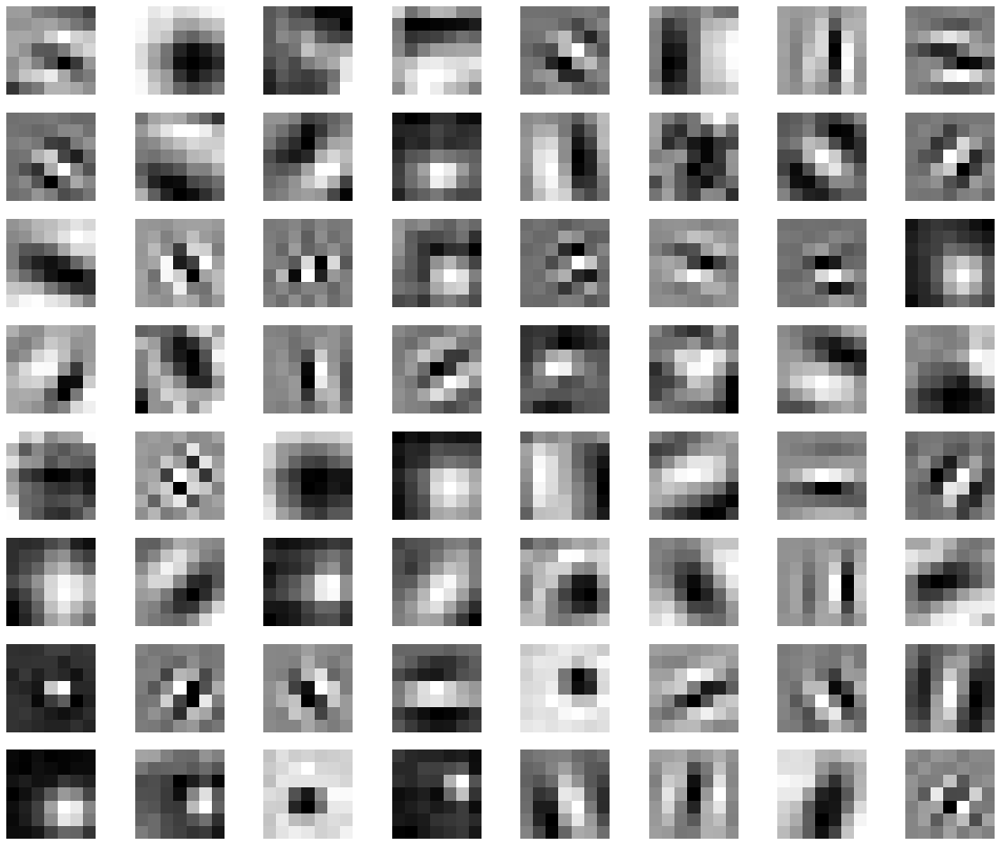

In [ ]:
# In this section we can see the filters
plt.figure(figsize=(20, 17))
for i, filter in enumerate(model_weights[0]):
    #print(i)
    plt.subplot(8, 8, (i+1)) # (8, 8) because in conv0 we have 7x7 filters and total of 64 (see printed shapes)
    plt.imshow((filter[0, :, :]).cpu().detach(), cmap='gray')
    plt.axis('off')
    #plt.savefig('../outputs/filter.png')
plt.show()

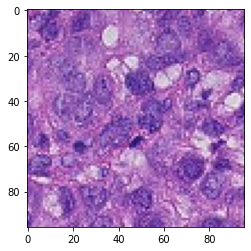

torch.Size([3, 512, 512])
torch.Size([1, 3, 512, 512])


In [ ]:
# Here we will see a sample of our dataset 

from torchvision import transforms
#shuffled_data = shuffle(data)
for i, idx in enumerate(data[data['label'] == 1]['id'][:13]):
    path = os.path.join(train_path, idx)
    img = readImage(path + '.tif')

# here we will just see if the same img from above is plotted
plt.imshow(img)
plt.show()
# define the transforms
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((512, 512)),
    transforms.ToTensor(),
])
img = np.array(img)
# apply the transforms
img = transform(img)
print(img.size())
# unsqueeze to add a batch dimension
img = img.unsqueeze(0)
print(img.size())


In [ ]:
# pass the image through all the layers
results = [conv_layers[0](img)]
for i in range(1, len(conv_layers)):
    # pass the result from the last layer to the next layer
    results.append(conv_layers[i](results[-1]))
# make a copy of the `results`
outputs = results


torch.Size([64, 256, 256])
Saving layer 0 feature maps...


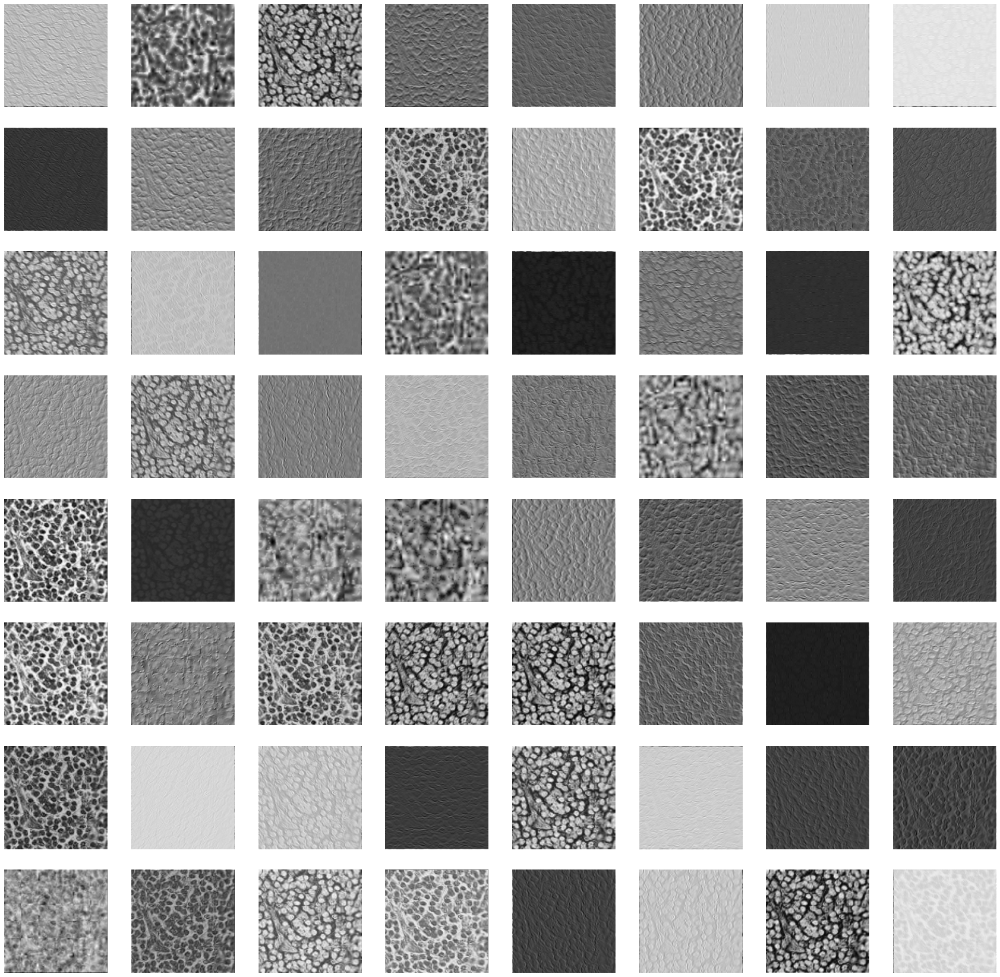

torch.Size([64, 256, 256])
Saving layer 1 feature maps...


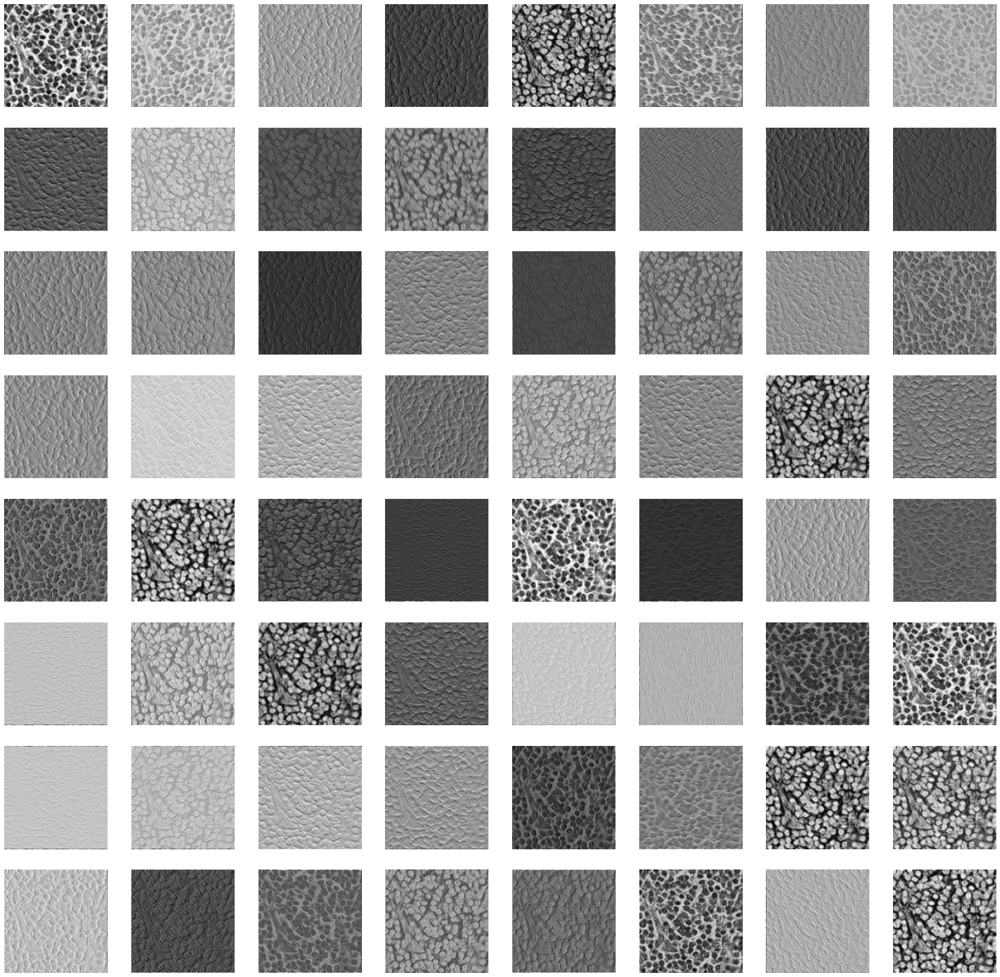

torch.Size([64, 256, 256])
Saving layer 2 feature maps...


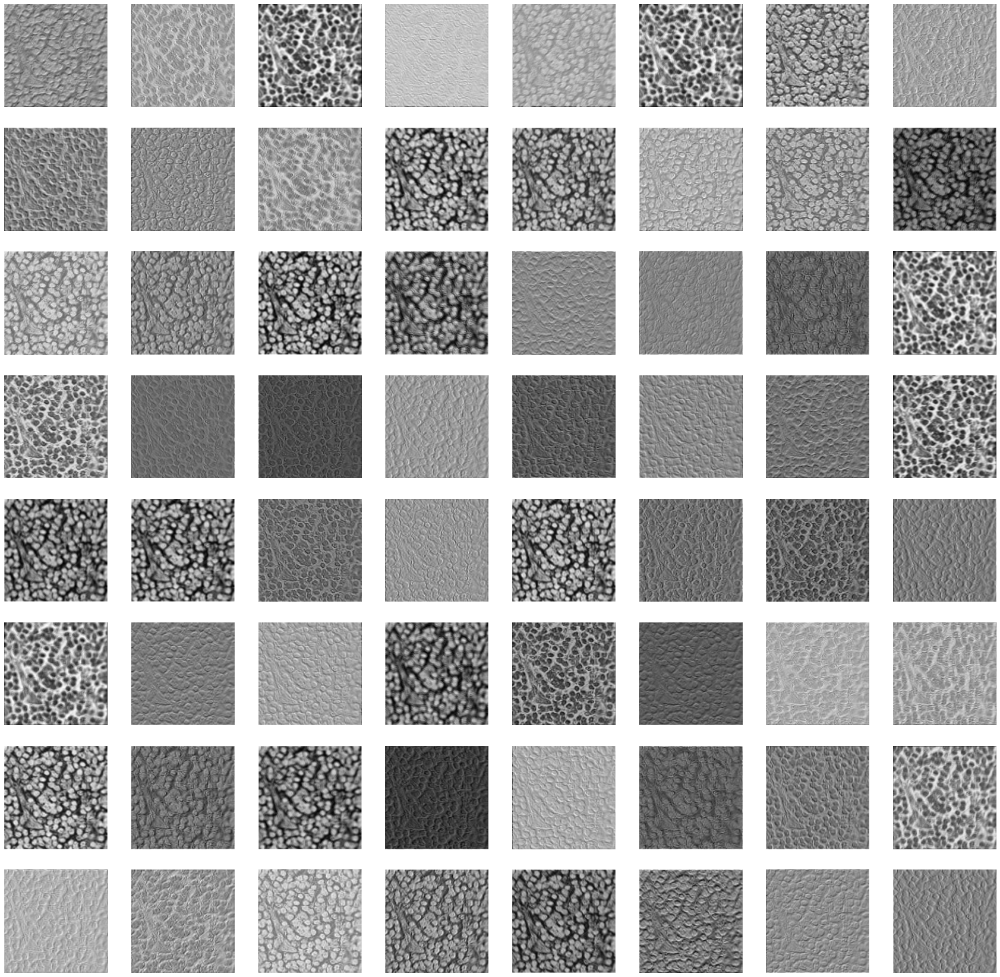

torch.Size([256, 256, 256])
Saving layer 3 feature maps...


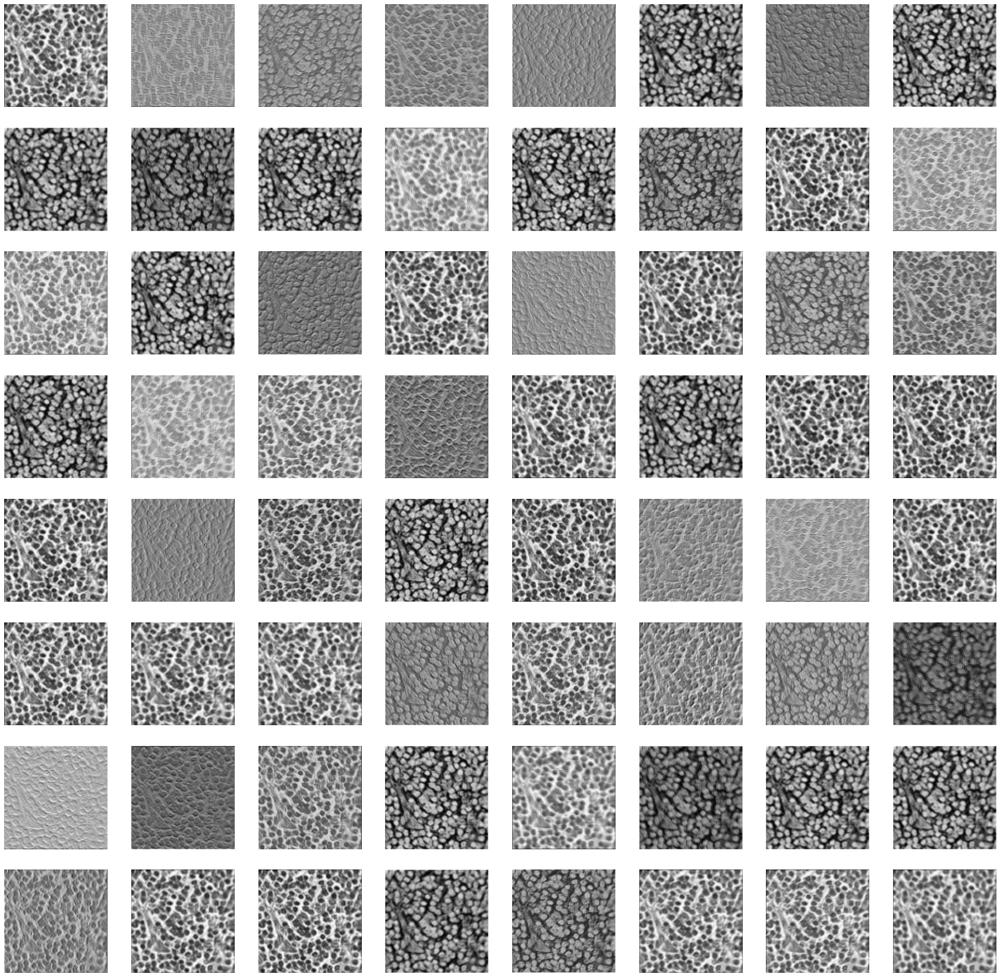

torch.Size([64, 256, 256])
Saving layer 4 feature maps...


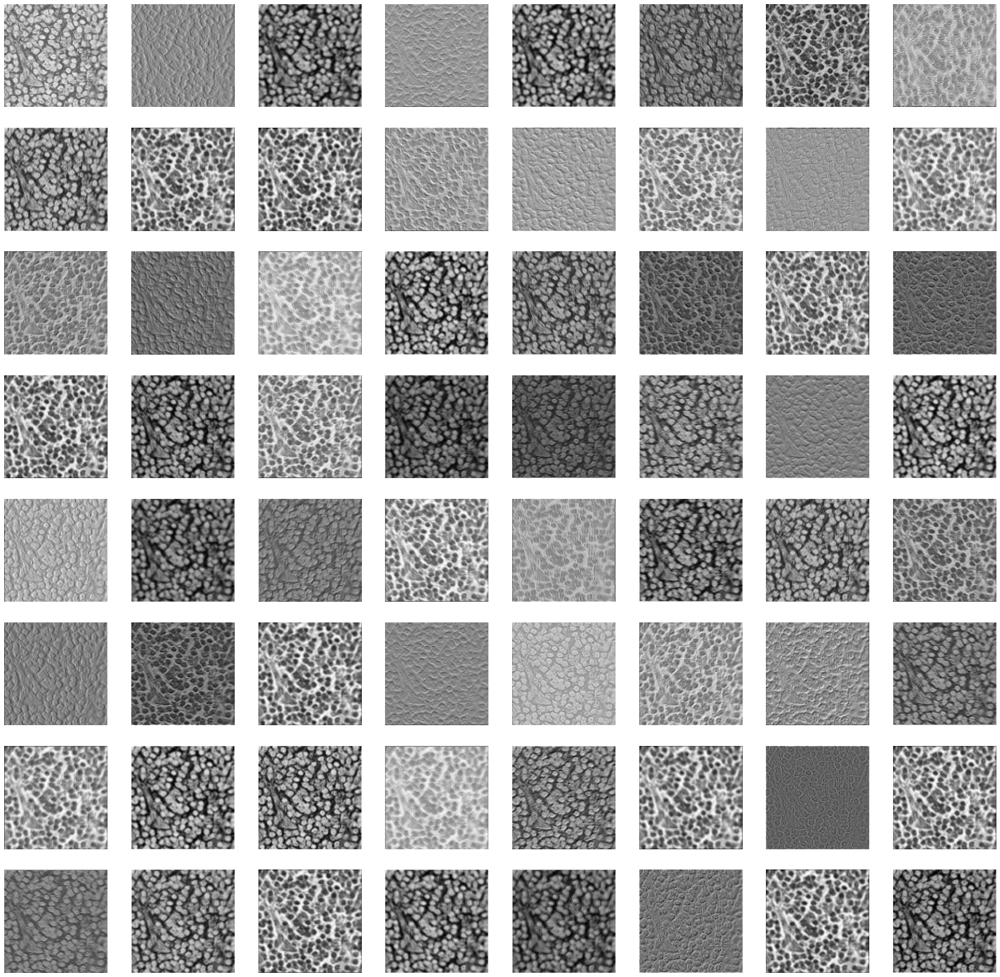

torch.Size([64, 256, 256])


KeyboardInterrupt: ignored

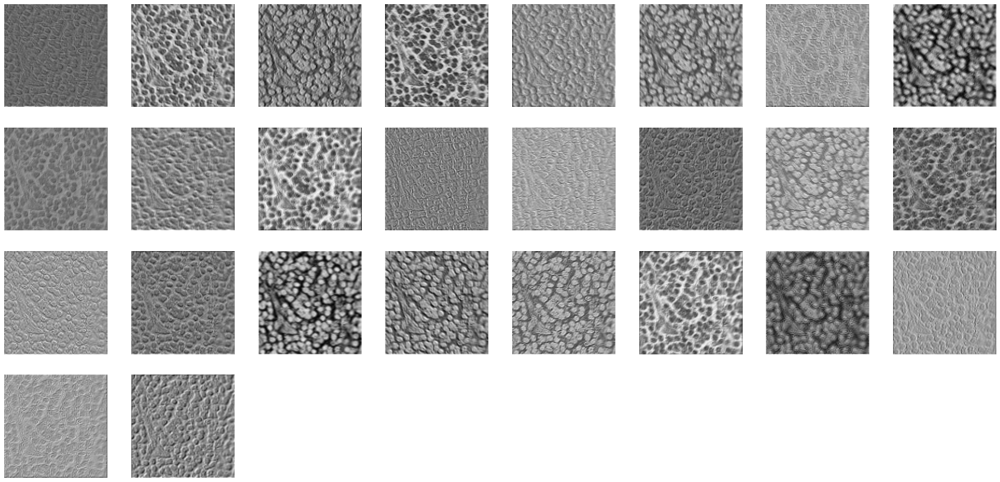

In [ ]:
# visualize 64 features from each layer 
# (although there are more feature maps in the upper layers)
for num_layer in range(len(outputs)):
    plt.figure(figsize=(30, 30) )
    
       
    # layer_viz = (outputs[num_layer][0, :, :, :])  /////   This is the original without change
    layer_viz = (outputs[num_layer][0, :, :, :]).cpu()
    layer_viz = layer_viz.data
    print(layer_viz.size())
    for i, filter in enumerate(layer_viz):
        if i == 64: # we will visualize only 8x8 blocks from each layer
            break
        plt.subplot(8, 8, i + 1)
        plt.imshow(filter, cmap='gray')
        plt.axis("off")
        #plt.title('Negative')
    
    
    print(f"Saving layer {num_layer} feature maps...")
    #plt.savefig(f"../outputs/layer_{num_layer}.png")
    plt.show()
    #plt.close()

## 8.2 Gradient-Weighted Class Activation Mapping (Grad-CAM)
Generate GradCAMs from samples of our dataset.

In [ ]:
from fastai.callbacks.hooks import *

# hook into forward pass
def hooked_backward(m, oneBatch, cat):
    # we hook into the convolutional part = m[0] of the model
    with hook_output(m[0]) as hook_a: 
        with hook_output(m[0], grad=True) as hook_g:
            preds = m(oneBatch)
            preds[0,int(cat)].backward()
    return hook_a,hook_g

In [ ]:
# We can create a utility function for getting a validation image with an activation map
def getHeatmap(val_index):
    """Returns the validation set image and the activation map"""
    # this gets the model
    m = learner.model.eval()
    tensorImg,cl = imgDataBunch.valid_ds[val_index]
    # create a batch from the one image
    oneBatch,_ = imgDataBunch.one_item(tensorImg)
    oneBatch_im = vision.Image(imgDataBunch.denorm(oneBatch)[0])
    # convert batch tensor image to grayscale image with opencv
    cvIm = cv2.cvtColor(image2np(oneBatch_im.data), cv2.COLOR_RGB2GRAY)
    # attach hooks
    hook_a,hook_g = hooked_backward(m, oneBatch, cl)
    # get convolutional activations and average from channels
    acts = hook_a.stored[0].cpu()
    #avg_acts = acts.mean(0)

    # Grad-CAM
    grad = hook_g.stored[0][0].cpu()
    grad_chan = grad.mean(1).mean(1)
    grad.shape,grad_chan.shape
    mult = (acts*grad_chan[...,None,None]).mean(0)
    return mult, cvIm


In [ ]:
from random import randint
# Then, modify our plotting func a bit
def plot_heatmap_overview(interp:ClassificationInterpretation, classes=['Negative','Tumor']):
    # top losses will return all validation losses and indexes sorted by the largest first
    tl_val,tl_idx = interp.top_losses()
    #classes = interp.data.classes
    fig, ax = plt.subplots(7,8, figsize=(22,20))
    fig.suptitle('Grad-CAM\nPredicted / Actual / Loss / Probability',fontsize=20)
    # Random
    for i in range(8):
        random_index = randint(0,len(tl_idx))
        idx = tl_idx[random_index]
        act, im = getHeatmap(idx)
        H,W = im.shape
        _,cl = interp.data.dl(DatasetType.Valid).dataset[idx]
        cl = int(cl)
        ax[0,i].imshow(im)
        ax[0,i].imshow(im, cmap=plt.cm.gray)
        ax[0,i].imshow(act, alpha=0.5, extent=(0,H,W,0),
              interpolation='bilinear', cmap='inferno')
        ax[0,i].set_xticks([])
        ax[0,i].set_yticks([])
        ax[0,i].set_title(f'{classes[interp.pred_class[idx]]} / {classes[cl]} / {interp.losses[idx]:.2f} / {interp.preds[idx][cl]:.2f}', fontsize=8)
    ax[0,0].set_ylabel('Random samples', fontsize=16, rotation=0, labelpad=80)
        
    
    # Most incorrect or top losses
    for i in range(8):
        idx = tl_idx[i]
        act, im = getHeatmap(idx)
        H,W = im.shape
        _,cl = interp.data.dl(DatasetType.Valid).dataset[idx]
        cl = int(cl)
        ax[1,i].imshow(im)
        ax[1,i].imshow(im, cmap=plt.cm.gray)
        ax[1,i].imshow(act, alpha=0.5, extent=(0,H,W,0),
              interpolation='bilinear', cmap='inferno')
        ax[1,i].set_xticks([])
        ax[1,i].set_yticks([])
        ax[1,i].set_title(f'{classes[interp.pred_class[idx]]} / {classes[cl]} / {interp.losses[idx]:.2f} / {interp.preds[idx][cl]:.2f}', fontsize=8)
    ax[1,0].set_ylabel('Most incorrect\nsamples 1', fontsize=16, rotation=0, labelpad=80)

    for i in range(8):
        idx = tl_idx[i + 8]
        act, im = getHeatmap(idx)
        H,W = im.shape
        _,cl = interp.data.dl(DatasetType.Valid).dataset[idx]
        cl = int(cl)
        ax[2,i].imshow(im)
        ax[2,i].imshow(im, cmap=plt.cm.gray)
        ax[2,i].imshow(act, alpha=0.5, extent=(0,H,W,0),
              interpolation='bilinear', cmap='inferno')
        ax[2,i].set_xticks([])
        ax[2,i].set_yticks([])
        ax[2,i].set_title(f'{classes[interp.pred_class[idx]]} / {classes[cl]} / {interp.losses[idx]:.2f} / {interp.preds[idx][cl]:.2f}', fontsize=8)
    ax[2,0].set_ylabel('Most incorrect\nsamples 2', fontsize=16, rotation=0, labelpad=80)

    for i in range(8):
        idx = tl_idx[i + 16]
        act, im = getHeatmap(idx)
        H,W = im.shape
        _,cl = interp.data.dl(DatasetType.Valid).dataset[idx]
        cl = int(cl)
        ax[3,i].imshow(im)
        ax[3,i].imshow(im, cmap=plt.cm.gray)
        ax[3,i].imshow(act, alpha=0.5, extent=(0,H,W,0),
              interpolation='bilinear', cmap='inferno')
        ax[3,i].set_xticks([])
        ax[3,i].set_yticks([])
        ax[3,i].set_title(f'{classes[interp.pred_class[idx]]} / {classes[cl]} / {interp.losses[idx]:.2f} / {interp.preds[idx][cl]:.2f}', fontsize=8)
    ax[3,0].set_ylabel('Most incorrect\nsamples 3', fontsize=16, rotation=0, labelpad=80)
    
    # Most correct or least losses
    for i in range(8):
        idx = tl_idx[len(tl_idx) - i - 1]
        act, im = getHeatmap(idx)
        H,W = im.shape
        _,cl = interp.data.dl(DatasetType.Valid).dataset[idx]
        cl = int(cl)
        ax[4,i].imshow(im)
        ax[4,i].imshow(im, cmap=plt.cm.gray)
        ax[4,i].imshow(act, alpha=0.5, extent=(0,H,W,0),
              interpolation='bilinear', cmap='inferno')
        ax[4,i].set_xticks([])
        ax[4,i].set_yticks([])
        ax[4,i].set_title(f'{classes[interp.pred_class[idx]]} / {classes[cl]} / {interp.losses[idx]:.2f} / {interp.preds[idx][cl]:.2f}', fontsize=8)
    ax[4,0].set_ylabel('Most correct\nsamples 1', fontsize=16, rotation=0, labelpad=80)

    for i in range(8):
        idx = tl_idx[len(tl_idx) - i - 8]
        act, im = getHeatmap(idx)
        H,W = im.shape
        _,cl = interp.data.dl(DatasetType.Valid).dataset[idx]
        cl = int(cl)
        ax[5,i].imshow(im)
        ax[5,i].imshow(im, cmap=plt.cm.gray)
        ax[5,i].imshow(act, alpha=0.5, extent=(0,H,W,0),
              interpolation='bilinear', cmap='inferno')
        ax[5,i].set_xticks([])
        ax[5,i].set_yticks([])
        ax[5,i].set_title(f'{classes[interp.pred_class[idx]]} / {classes[cl]} / {interp.losses[idx]:.2f} / {interp.preds[idx][cl]:.2f}', fontsize=8)
    ax[5,0].set_ylabel('Most correct\nsamples 2', fontsize=16, rotation=0, labelpad=80)

    for i in range(8):
        idx = tl_idx[len(tl_idx) - i - 16]
        act, im = getHeatmap(idx)
        H,W = im.shape
        _,cl = interp.data.dl(DatasetType.Valid).dataset[idx]
        cl = int(cl)
        ax[6,i].imshow(im)
        ax[6,i].imshow(im, cmap=plt.cm.gray)
        ax[6,i].imshow(act, alpha=0.5, extent=(0,H,W,0),
              interpolation='bilinear', cmap='inferno')
        ax[6,i].set_xticks([])
        ax[6,i].set_yticks([])
        ax[6,i].set_title(f'{classes[interp.pred_class[idx]]} / {classes[cl]} / {interp.losses[idx]:.2f} / {interp.preds[idx][cl]:.2f}', fontsize=8)
    ax[6,0].set_ylabel('Most correct\nsamples 3', fontsize=16, rotation=0, labelpad=80)

In [ ]:
plot_heatmap_overview(interp, ['Negative', 'Tumor'])

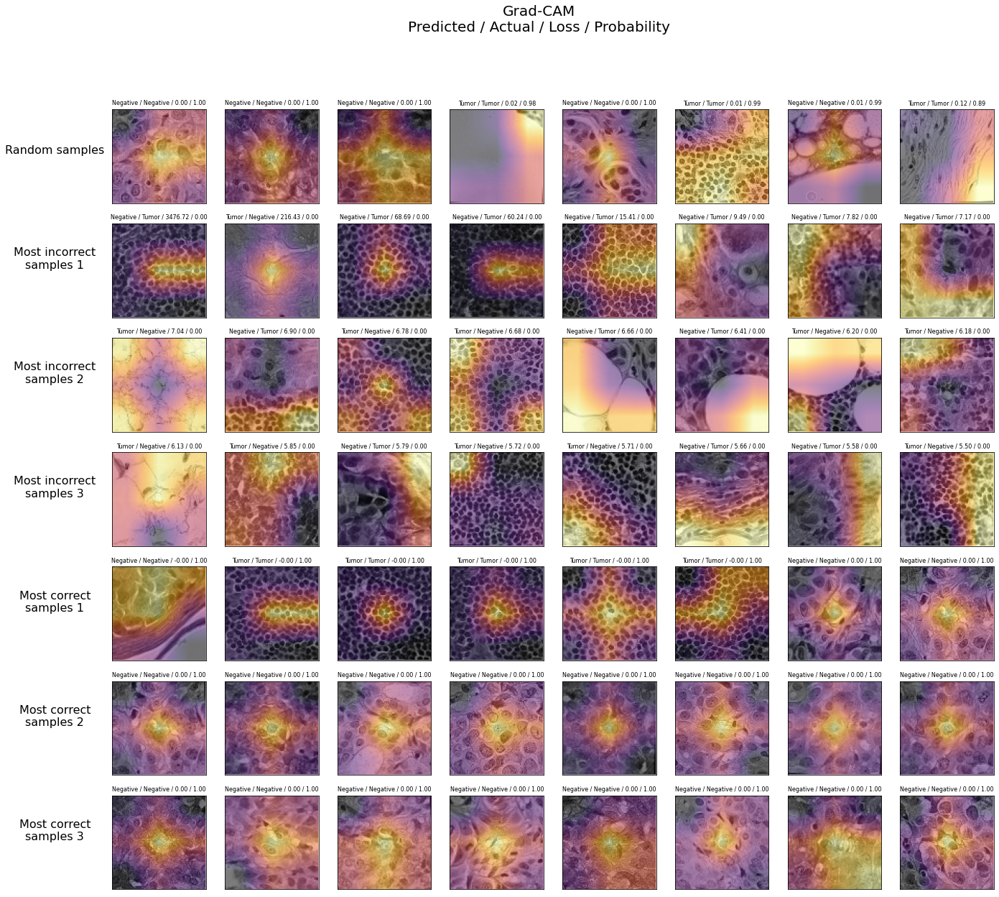

In [ ]:
plot_heatmap_overview(interp, ['Tumor', 'Negative'])